# Логистическая регрессия и случайный лес, домашнее задание

## Обзор

В задании вам предстоит на простом примере познакомиться с базовыми инструментами построения логистической регрессии:
* визуализация
* разбиение данных на обучающую и тестовую выборки
* преобразование переменных
* отбор переменных
* $L1$ и $L2$ регуляризации
* построение итоговой модели и валидация

Далее вы построите случайный лес и сравните два класса моделей.

Все это будет на сгенерированных данных.
Примеры многих функций уже есть в коде, остальное можно посмотреть в официальных документациях или просто поискать в интернете примеры применения.

Оценка будет выставляться с учетом первых трех заданий, третье опционально

## Сгенерируем данные

In [1]:
import numpy as np
from sklearn.datasets import make_classification
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from math import ceil
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from pprint import pprint
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.model_selection import GridSearchCV
import sklearn.metrics
import sklearn.model_selection
import autosklearn
import scipy.stats as st
              


X, y = make_classification(n_samples=7000, n_features=20, n_informative=5, n_redundant=2,
                           n_repeated=0, scale=None, shift=None, shuffle=False, class_sep=0.5, 
                           random_state=40)

In [2]:
X.shape, y.shape

((7000, 20), (7000,))

Разбивка на train и test нужна для того, чтобы оставить часть данных нетронутой для проверки

Модель мы будем применять на данных, которые еще не видели, и разбивка позволяет нам хоть немного имитировать этот процесс

Если хотим использовать методы, требующие ручного подбора параметров (например, коэффициента регуляризации), можно выделить еще третий вид выборки — валидационную или validation. Подбор параметров традиционно выглядит так:
1. задаем параметр;
2. обучаем модель на train;
3. смотрим на качество предсказания на validation;
4. снова задаем параметр, возвращаемся к п.2;
5. ищем максимум качества на валидации;
6. выбираем параметры, которые лучше всего себя показали на validation, обучаем еще раз модель, проверяем итоги на test.

Если ручных параметров нет, можно делить выборку на 2 части — train, test

Выборка бьется последовательным применением train_test_split

Стандартные пропорции: 70:30 в случае с train/test, 60:20:20 в случае с train/val/test

In [2]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

## Можно визуализировать зависимости, посмотреть на характер данных

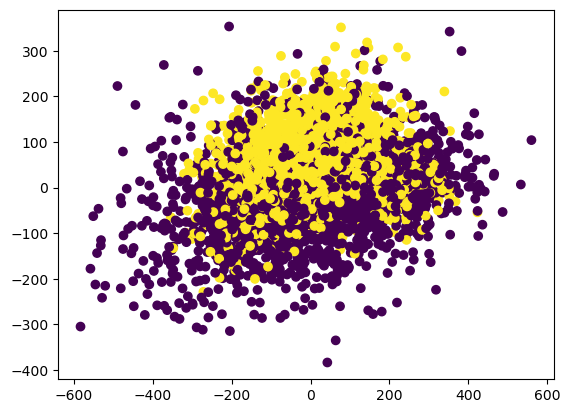

In [9]:
plt.scatter(X_train[:, 0], X_train[:, 1], c=y_train)
plt.show()

In [271]:
df = pd.DataFrame(np.append(X, y[:, np.newaxis], axis = 1))
df.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,-621.578763,-169.211895,89.414557,-78.903131,-26.731402,141.032268,39.389168,-18.777040,-1.738580,18.501089,...,46.730170,-9.968648,36.788975,-35.089049,-128.232041,-63.039599,15.020217,108.425941,-8.573379,0.0
1,-583.516627,57.760474,-94.073597,-63.805919,-89.137473,49.482030,3.688442,8.395622,-1.099120,-20.040514,...,-11.053576,-39.982496,14.641007,3.610509,-93.756549,-35.361443,-27.793638,-101.637520,-14.497597,0.0
2,-575.557573,99.329169,-28.685001,33.533627,-11.706835,-34.293447,-30.067031,12.976128,1.401020,-8.177246,...,-41.827029,78.336703,9.791404,3.728595,77.153235,-21.595443,95.528189,72.298890,-20.124996,0.0
3,-558.351131,-70.074029,74.729164,30.015865,-45.854628,163.127878,-34.003829,-28.428485,6.392218,6.796828,...,14.219447,-27.856380,21.811676,40.837319,-38.775834,-74.950320,49.728842,-52.722803,51.204517,0.0
4,-551.129632,4.541231,-111.525376,-75.144675,-13.596824,-39.504761,58.366137,2.048067,-4.038327,6.228075,...,4.076987,77.082123,70.087053,-23.321515,-18.700076,-21.073950,91.634220,0.615705,2.390110,0.0


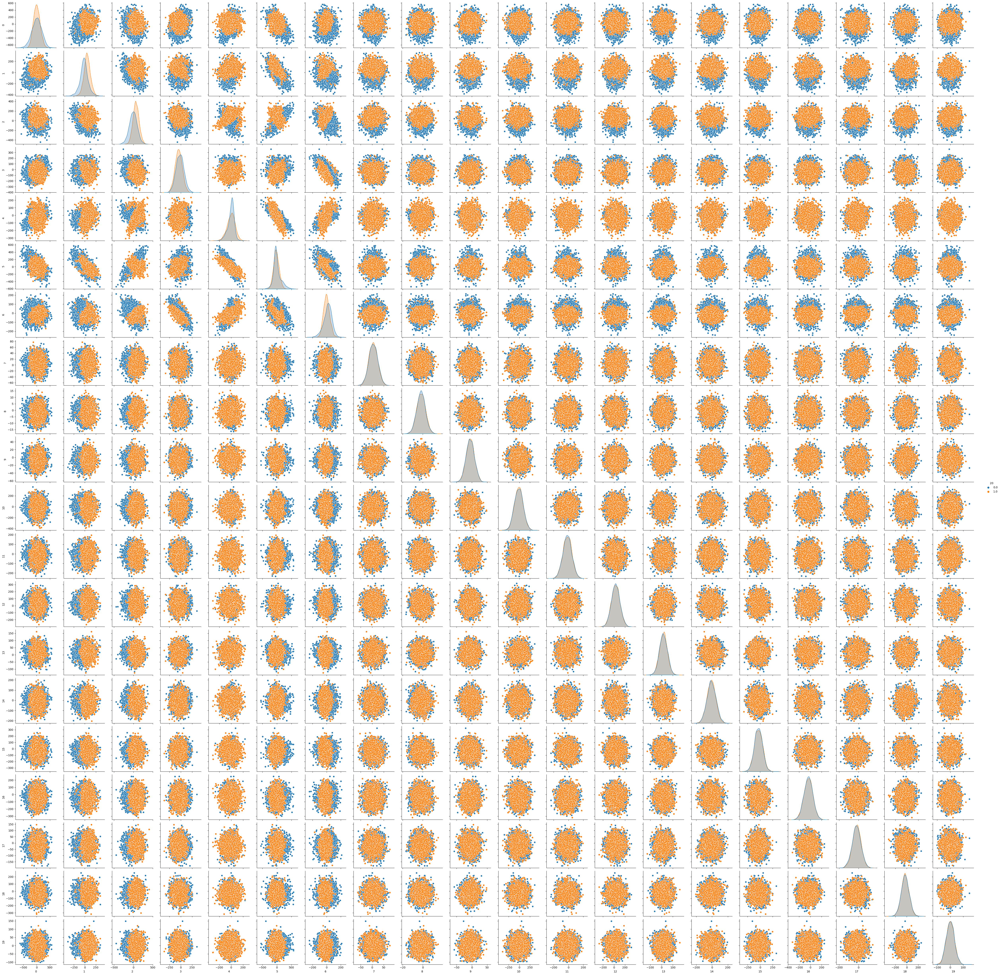

In [42]:
sns.pairplot(df, hue=20)

`как видно из пейрплота только первые 7 признаков несут какую-то информацию по которой можно разделить наблюдения на 2 класса`

<AxesSubplot:>

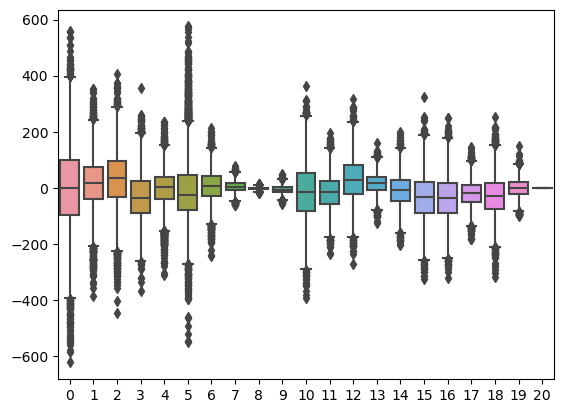

In [43]:
sns.boxplot(data=df)

`как видно из карицы и боксплотов в данных достаточно много аутлайеров. Если бы это были реальные данные, важно было бы проверить что это за значения, с возможностью их исключить.`



`так как данные синтетические - нет смысла проверять данные на наличие пропущенных значений`

In [46]:
df.corr().style.background_gradient(cmap='coolwarm')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
0,1.000000,0.233488,-0.136261,0.211475,0.165459,-0.416485,-0.133204,0.006277,-0.020387,-0.006855,-0.024027,0.019743,-0.012380,-0.003977,0.002107,0.005239,0.010774,-0.004111,0.001901,-0.005169,-0.002803
1,0.233488,1.000000,-0.071593,0.037344,0.145474,-0.599796,-0.259675,-0.005291,-0.000147,0.007088,-0.005184,0.023387,0.002194,0.006465,-0.014982,-0.004220,-0.007234,0.036241,-0.003574,-0.011399,0.387118
2,-0.136261,-0.071593,1.000000,-0.171050,-0.029840,0.375121,-0.295525,-0.003924,0.004776,-0.015863,0.023223,-0.015256,-0.004579,-0.008508,-0.007161,0.012241,0.020629,-0.000687,0.013750,0.012558,0.357004
3,0.211475,0.037344,-0.171050,1.000000,0.073332,0.087259,-0.658682,-0.002924,-0.009328,-0.004885,0.003324,0.004136,0.013461,0.023544,0.004889,0.005742,-0.017257,-0.022740,-0.010297,0.001129,-0.167846
4,0.165459,0.145474,-0.029840,0.073332,1.000000,-0.753021,0.482390,0.002469,0.011764,-0.008062,-0.003584,0.007193,-0.009967,-0.008829,0.017696,-0.009636,-0.001155,0.008435,-0.006055,-0.027781,0.006030
5,-0.416485,-0.599796,0.375121,0.087259,-0.753021,1.000000,-0.445415,-0.002718,-0.004168,-0.002934,0.018459,-0.023336,0.010149,0.006978,-0.006772,0.012736,0.004242,-0.026665,0.007209,0.029051,-0.095320
6,-0.133204,-0.259675,-0.295525,-0.658682,0.482390,-0.445415,1.000000,0.006808,0.012877,0.003910,-0.011780,-0.001112,-0.014025,-0.021099,0.014671,-0.014146,0.005155,0.010381,-0.000693,-0.018424,-0.156235
7,0.006277,-0.005291,-0.003924,-0.002924,0.002469,-0.002718,0.006808,1.000000,0.012434,-0.004234,0.005574,-0.009304,-0.009703,0.012499,0.014672,-0.012655,0.017483,-0.005138,0.005651,-0.028980,-0.015238
8,-0.020387,-0.000147,0.004776,-0.009328,0.011764,-0.004168,0.012877,0.012434,1.000000,0.000646,-0.003060,-0.000421,-0.032065,0.023370,-0.013849,0.000627,-0.010427,0.020140,-0.002620,0.008514,0.015895
9,-0.006855,0.007088,-0.015863,-0.004885,-0.008062,-0.002934,0.003910,-0.004234,0.000646,1.000000,-0.028091,0.014883,0.005760,0.018312,-0.001331,0.003092,0.004165,0.006784,0.017604,-0.010970,0.011683


`из гистограмм пейрплота видно что распределение данные всех признаков близко к норманальному`



`На матрице корреляций видно что вклад в разделение по классам могут внести фичеры 1 и 2 остальные признаки скорее всего безполезны`

`признаки 4 и 5 имеют очень сильную корреляюцию что означает что один из признаков можно исключить`

Первично анализировать признаки удобно с помощью woe_line.

Функция делит наблюдения на группы по $X$, для каждой группы считает WoE, и откладывает эти значения на графике.

Можно встретить определение WoE, отличающееся знаком, на анализ и выводы это не влияет

# Анализ данных

## Подготовка

## Задание 1

Написать функцию woe_line:

1. разбить наблюдения на n_buckets групп по $X$
2. в каждой группе по y отложить WoE, по x медианное значение $X$
3. вывести полученный график
4. вывести ROC AUC признака (sklearn.metrics.roc_auc_score)
5. Опционально. Рассчитать доверительный интервал для bad rate (bad rate - доля наблюдений с целевой переменной =1 от всех наблюдений в группе)
6. Опционально. Нанести на график линейное приближение любым способом

График позволит проверить линейность зависимости, силу переменной, опционально проверить распределение

In [283]:
def woe_line(X,         # 1-d array with independent feature 
             y,         # 1-d array with target feature
             n_buckets,#, # number of buckets to plot
             var_nm = None,    # optional, var_name to show above the plot
             target_nm = None,
             clip = None, # optional, target_name to show above the plot
             plot_hist= None):  # optional, if True — histogram of X is displayed
        
        if plot_hist:
            plt.hist(X, bins = n_buckets, color = 'skyblue')
            plt.twinx()
        woe_all_arr = np.log((sum(y)/len(y))/((len(y)-sum(y))/len(y)))
        
        x_y = [(a, b) for a, b in zip(X, y) if clip[0] <= a <=clip[1]] if clip else [(a, b) for a, b in zip(X, y)]
        x_y.sort(key=lambda x: x[0])
        
        #defenition of ndex for slie array to buckets
        ind_bucket = ceil(len(x_y)/n_buckets)
        buckets = np.array([np.array(x_y[ind_bucket * i :ind_bucket*(i+1)]) for i in range(n_buckets)],  dtype=object)
        
        #let's collect woe and bad_rate per bucket
        woe, bad_rate = [], []
        
        #calc woe for each buket
        for buck in buckets:
            ones = buck[:, 1].sum()
            #woe for class one "o" and class zero "z"
            o, z = ones/len(buck),  (len(buck)-ones)/len(buck)
            #cup woe value to avoid infinity
            if o == 0:
                o = 0.001
            elif o == 1:
                o = 0.999
            if z == 0:
                z = 0.001
            elif z == 1:
                z = 0.999
            bad_rate.append(o)
            bucket_woe = np.log(o/z) - woe_all_arr
            woe.append(round(bucket_woe, 3))

        #graphic settings
        plt.grid()
        plt.xlabel("Feature value", loc = 'center')
        plt.ylabel("Woe", loc = 'center')
        
        
        # calc mean per bucket
        buck_mean = [np.median(b[:, 0], axis = 0) for b in buckets]
        
        #interpolation line
        model = LinearRegression()
        model.fit(np.array(buck_mean).reshape((-1, 1)), woe)
        
        # if plot hist and add interpolation lines
        if plot_hist:
            interpolation_line = model.intercept_ + model.coef_*[min(X), max(X)]
            plt.plot([min(X), max(X)], interpolation_line)
        else: 
            interpolation_line = model.intercept_ + model.coef_*buck_mean
            plt.plot(buck_mean, interpolation_line)


        #calculation of error
        def buck_std(buck):
            sum_ = sum([(el - y.mean())**2  for el in buck[:, 1]])
            std = (sum_/len(buck))**0.5
            return sum_
        error = [1.96*buck_std(buck)/(2*len(buck)) for buck in buckets]
        
        #conf int for bad rate
        conf_bad_rate = st.norm.interval(alpha= 0.95 , loc=np.mean(bad_rate), scale=st.sem(bad_rate))
        
 
        
        plt.errorbar(buck_mean, woe, fmt = 'o', yerr = error, lw=1, capsize = 2, capthick= 2, color = 'red', linestyle = '--')
        plt.legend(['interpolation', 'Woe'])
        auc = roc_auc_score(y, X)
        plt.title(f'{var_nm}|{target_nm} AUC: {auc:.2f}, conf bad rate ({conf_bad_rate[0]:.2f}, {conf_bad_rate[1]:.2f})')


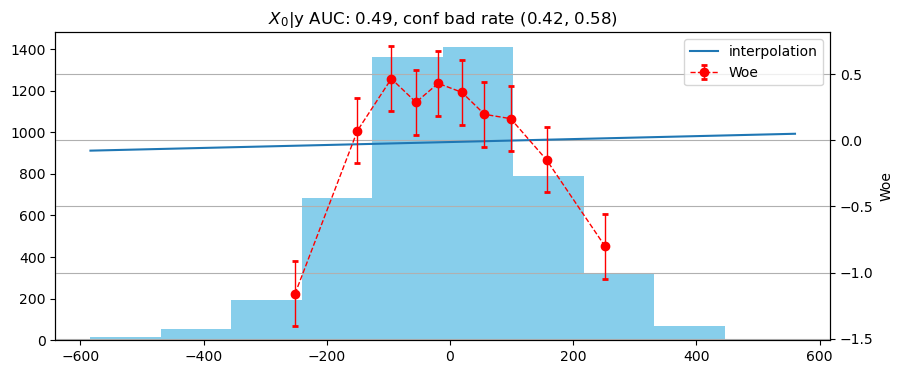

In [278]:
plt.figure(figsize=(10, 4))
woe_line(X_train[:, 0], y_train, n_buckets=10, var_nm='$X_0$', target_nm='y', plot_hist= True )

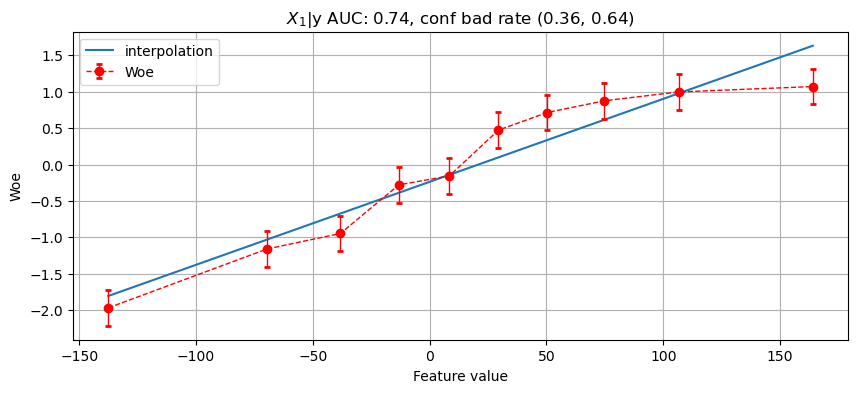

In [282]:
plt.figure(figsize=(10, 4))
woe_line(X_train[:, 1], y_train, n_buckets=10, var_nm='$X_1$', target_nm='y')

На примере функция дополнительно отображает $R^2$ — меру линейности зависимости, а также линию, показывающую линейное приближение

## Анализ каждой переменной

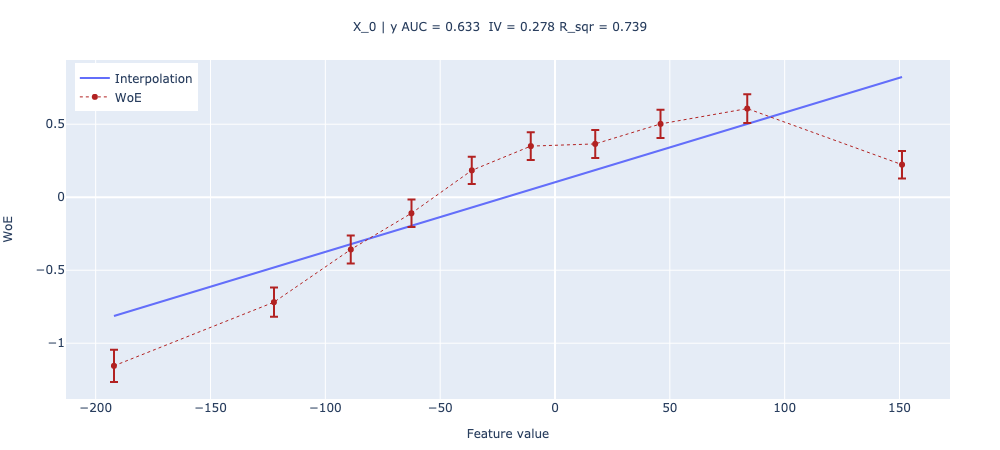

In [3]:
res = woe_line(X_train[:, 0], y_train, n_buckets=10, plot_hist=False, 
               var_nm = 'X_0', target_nm = 'y')

Видно, что переменная разделяет целевую переменную примерно до значения 0, дальше кривая выходит на плато. Можно ограничить этот хвост, чтобы не закладывать разделение в модель

Можно сразу в woe_line передавать преобразованную переменную, важно потом при проверках модели на test не забыть сделать то же преобразование

Для борьбы с выбросами можно также ограничивать длинные хвосты распределения. Особенно это полезно в реальном применении модели, чтобы ограничить влияние одной переменной на предсказание всей модели

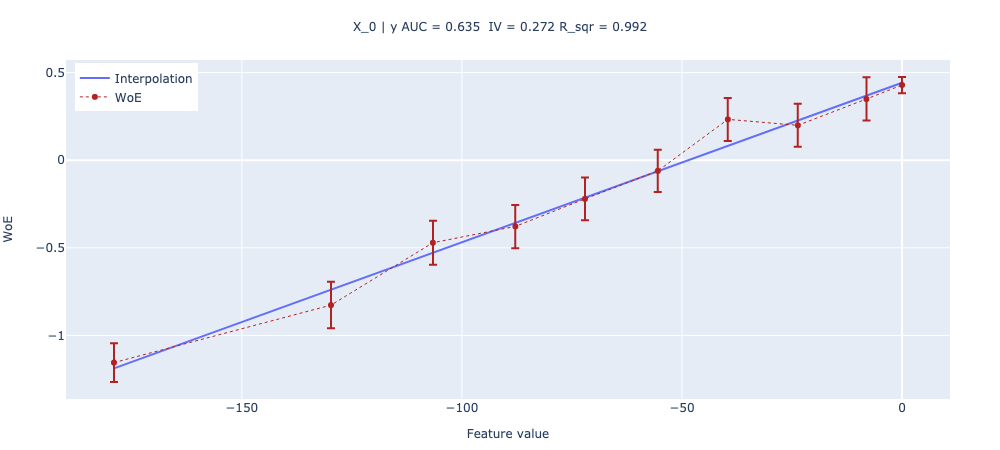

In [4]:
res = woe_line(np.clip(X_train[:, 0], -200, 0), y_train, n_buckets=10, plot_hist=False, 
               var_nm = 'X_0', target_nm = 'y')

При преобразовании переменных важно соблюдать баланс:

1. переменная должна стать линейной,
2. не стоит доводить до идеальной линейности в ущерб разделяющей силы (ROC AUC),
3. в работе с реальными данными стоит обращать внимание на физический смысл переменных. Например, в случае с размерными переменными (рубли, метры), часто помогает взятие корня или логарифма, а еще лучше приводить их к безразмерным величинам нормировкой.

## Задание 2

1. проверить каждую переменную на woe_line,
2. каждую полезную переменную линеаризовать (для каждой переменной нужны графики ДО и ПОСЛЕ),
3. ненужные переменные (слабые по ROC AUC, немонотонные) исключить из модели,
4. на отобранных и линеаризованных переменных построить модель, проверить результат на test по ROC AUC.

Подробно про обучение моделей можно почитать в официальной документации, там же есть примеры использования

https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html

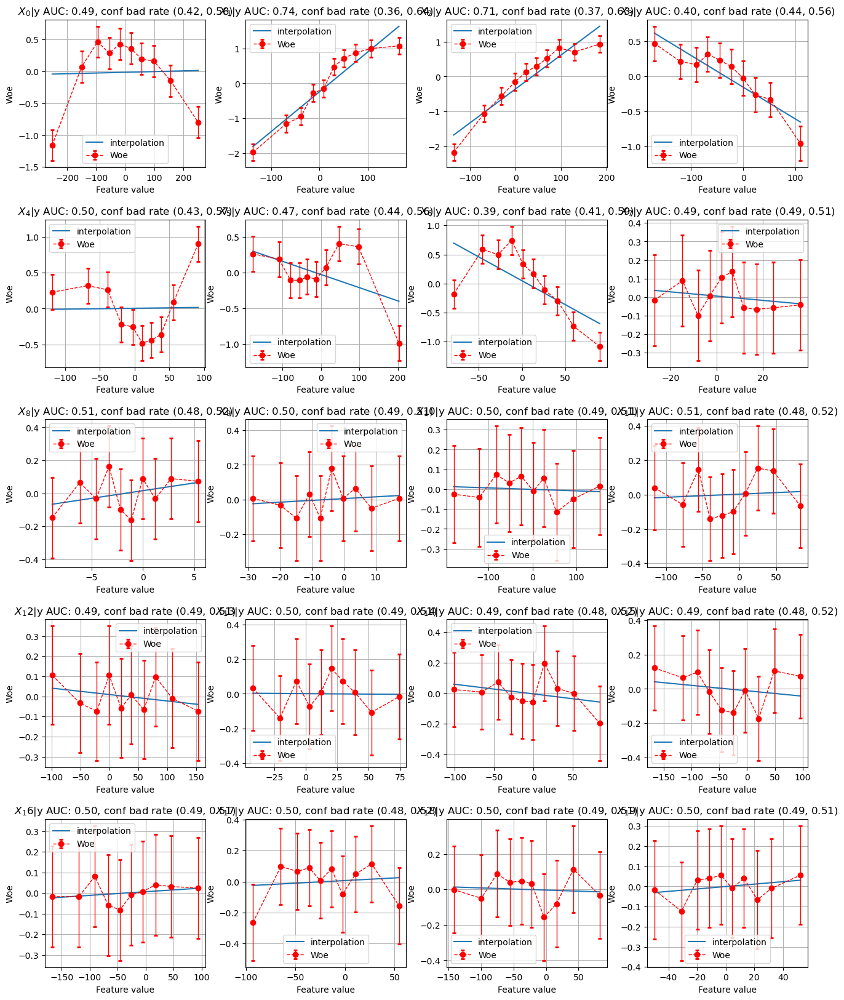

In [284]:
fig = plt.figure(figsize=(16, 20))
rows = 5
columns = 4
grid = plt.GridSpec(rows, columns, wspace = .25, hspace = .35)
for i in range(rows*columns):
    
    exec (f"plt.subplot(grid{[i]})")
    woe_line(X_train[:, i], y_train, n_buckets=10, var_nm=f'$X_{i}$', target_nm='y')

`из графиков видно что переменные 1 и 2 достаточно хорошо разделяют классы`

`так же можно попробовать поэкспериментировать с переменными 0, 3, 4, 5, 6`

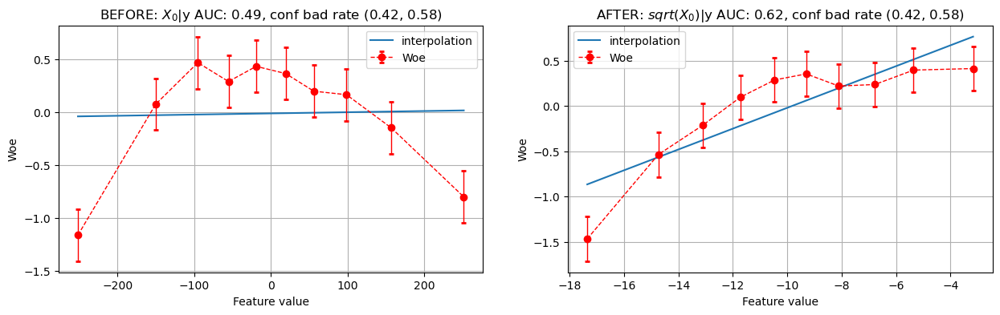

In [285]:
# нулевая переменная похожа на параболу (-х**2) по этому попробуем  преобразовать данные к линейному виду
x_0 = np.array([-(abs(el)**0.5) for el in X_train[:, 0]])
plt.figure(figsize=(15, 4))
plt.subplot(121)
woe_line(X_train[:, 0], y_train, n_buckets=10, var_nm=f'BEFORE: $X_0$', target_nm='y')
plt.subplot(122)
woe_line(x_0, y_train, n_buckets=10, var_nm='AFTER: $sqrt(X_0)$', target_nm='y')

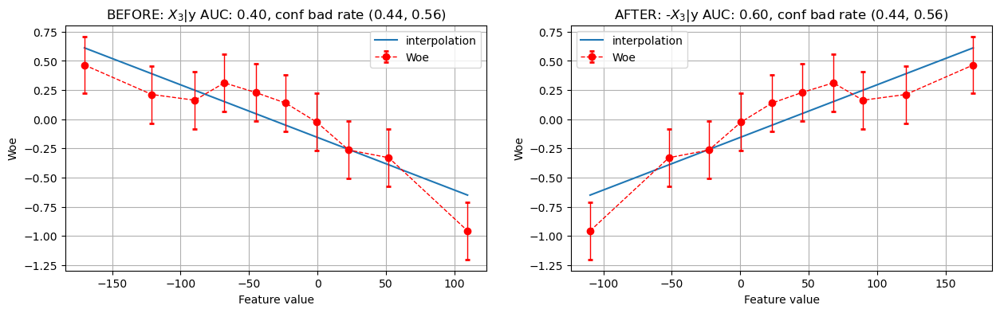

In [286]:
# попробуем поменять знак у третьей переменной
x_3 = np.array([-el for el in X_train[:, 3]])
plt.figure(figsize=(15, 4))
plt.subplot(121)
woe_line(X_train[:, 3], y_train, n_buckets=10, var_nm=f'BEFORE: $X_3$', target_nm='y')
plt.subplot(122)
woe_line(x_3, y_train, n_buckets=10, var_nm=f'AFTER: -$X_3$', target_nm='y')

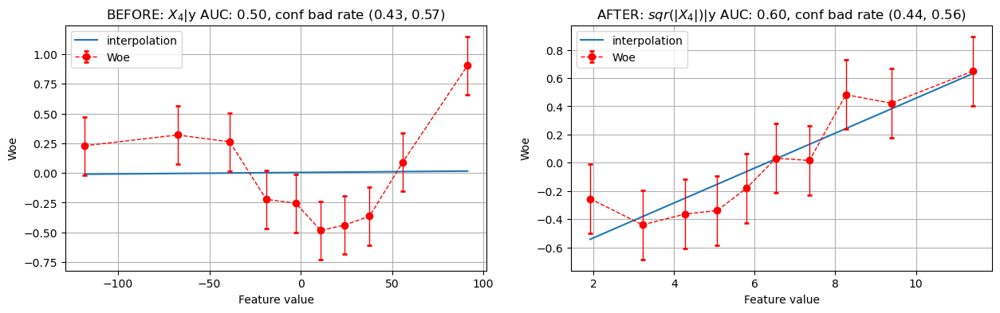

In [287]:
# у переменной 4 тоже попробуем извлечь корень
x_4 = np.array([(abs(el))**0.5 for el in X_train[:, 4]])
plt.figure(figsize=(15, 4))
plt.subplot(121)
woe_line(X_train[:, 4], y_train, n_buckets=10, var_nm='BEFORE: $X_4$', target_nm='y')
plt.subplot(122)
woe_line(x_4, y_train, n_buckets=10, var_nm='AFTER: $sqr(|X_4|)$', target_nm='y')

In [418]:
# манипуляции с переменной номер 5 не привели к результату

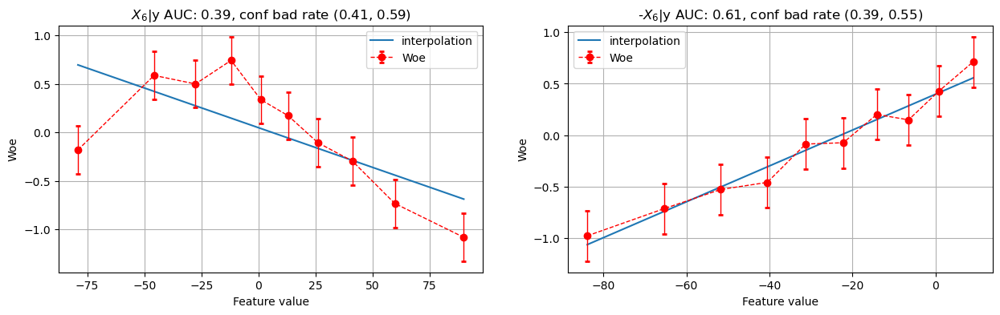

In [288]:
# попробуем поменять знак у шестой переменной и обрежем до значения 13
x_6 = np.array([-el for el in X_train[:, 6]])
plt.figure(figsize=(15, 4))
plt.subplot(121)
woe_line(X_train[:, 6], y_train, n_buckets=10, var_nm=f'$X_6$', target_nm='y')
plt.subplot(122)
woe_line(x_6, y_train, n_buckets=10, var_nm=f'-$X_6$', target_nm='y', clip=[-100, 13])

`в итоге для построения регрессии будем использовать переменные 1 и 2 без изменений и измененные переменные: 0, 3, 4, 6`

`в данной ситуации получилось много feature engeneering адекватность которого оценить достатоно сложно так как на синтетических данных нельзя понять логично ли применять подобные преобразования к признаку. А так же по причине того что из 20 признаков важных для решения задачи (без преобразований) всего два`

`в реальной ситуации было преобразованные признаки было бы логично проверить на выбросы и возможно удалить/изменить конкретные значения части данных`

# Построение логистической регрессии

In [3]:
scaler = MinMaxScaler()
def preprocessing_pipeline(X: np.array):
    X[:, 0] = np.array([-(abs(el)**0.5) for el in X[:, 0]])
    X[:, 3]  = np.array([-el for el in X[:, 3]])
    X[:, 4]  = np.array([(abs(el))**0.5 for el in X[:, 4]])
    X[:, 6]  = np.array([-el for el in X[:, 6]])
    #X = X[:, [0, 1, 2, 3, 4, 6]]
    X = X[:, [0, 1, 2, 4]]
    #X = X[:, [1,2]]
    scaled_data = scaler.fit_transform(X)
    return scaled_data

In [4]:
X_train_ = preprocessing_pipeline(X_train)
X_test_ = preprocessing_pipeline(X_test)

[[0.17316377558745444, 0.5909710606541564, 0.5328366955225733], [0.0835098538082093, 0.5909351019948305, 0.6043356204933231], [0.16916342149488628, 0.5728365541111251, 0.700300761480611], [0.13381601055152714, 0.6975473669257033, 0.6449764942277583], [0.1765163354575634, 0.6268508163945421, 0.7354477595584121], [0.38272239570505917, 0.5541155596644384, 0.7024387873787838], [0.3357431578915566, 0.6170200759687756, 0.6673343866039738], [0.7249455552082509, 0.6507327838859482, 0.592949369252577], [0.37498067738488317, 0.8662135969753666, 0.5531515817508761], [0.1964335881639272, 0.5429925865718698, 0.659479859373561], [0.3811526601202786, 0.7632155245232733, 0.7391882640012255], [0.1498832863289863, 0.7203383492382388, 0.5976298625260689], [0.1754796279128641, 0.46705364757443946, 0.5924002447342805], [0.09240557788871229, 0.505081318705906, 0.5579103712074122], [0.1602932179812342, 0.5609618865657796, 0.6759551471447367], [0.18976621003821492, 0.5146668202000696, 0.7069012917051399], [0.

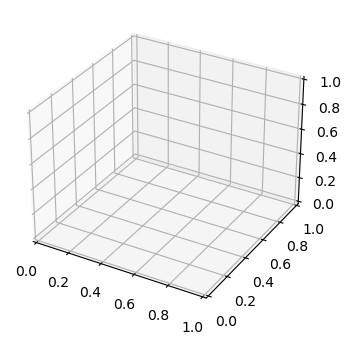

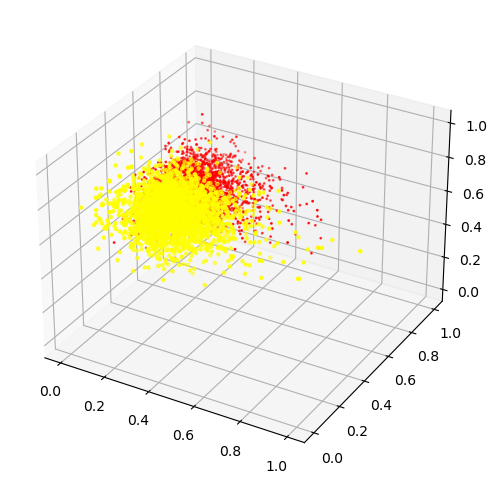

In [30]:
X_train_ = preprocessing_pipeline(X_train)
X_test_ = preprocessing_pipeline(X_test)

fig = plt.figure(figsize=(7, 4))
ax_3d = fig.add_subplot(projection='3d')
red = [[a[0], a[1], a[2]] for a, y in zip(X_train_, y_train) if y == 1]
blie = np.array([[a[0], a[1], a[2]] for a, y in zip(X_train_, y_train) if y == 0])
print(red)
a = np.array(red)[:, 0]
b = np.array(red)[:, 1]
c = np.array(red)[:, 2]
fig = plt.figure(figsize = (8,6))
ax = plt.axes(projection ="3d")
 
# Create Plot

ax.scatter3D(a, b, c, s=1, color='red')
ax.scatter3D(blie[:, 0], blie[:, 1], blie[:, 2], s=5, color='yellow')


In [33]:
%pip install mayavi

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 4.3 MB/s eta 0:00:0000:0100:01m
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.2/229.2 kB 2.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.9/268.9 kB 5.0 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 5.2 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 5.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 4.0 MB/s eta 0:00:0000:0100:01
  Using cached vtk-9.2.6-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (79.3 MB)
  Created wheel for mayavi: filename=mayavi-4.8.1-cp310-cp310-linux_x86_64.whl size=16167218 sha256=d58fa7efdb101bb9078347aad012070343322be05704710da00106cbda

In [46]:
%pip install PySide

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 10.6 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... error
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [1 lines of output]
      only these python versions are supported: [(2, 6), (2, 7), (3, 2), (3, 3), (3, 4)]
      [end of output]
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Note: you may need to restart the kernel to use updated packages.


In [5]:
import mayavi.mlab as mylab
mylab.points3d(X_test_[:, 0], X_test_[:, 1], X_test[:, 2], y_train)
mylab.show()

QSocketNotifier: Can only be used with threads started with QThread


: 

: 

In [585]:
X_train_ = preprocessing_pipeline(X_train)
X_test_ = preprocessing_pipeline(X_test)

model_LR = LogisticRegression()
model_LR.fit(X_train_, y_train)
y_pred = model_LR.predict(X_test_)
auc = roc_auc_score(y_test, y_pred)
acc = accuracy_score(y_test, y_pred)
f'AUC: {auc:.3f}, ACC: {acc:.3f}'

'AUC: 0.756, ACC: 0.757'

In [59]:
model_LR_raw = LogisticRegression()
model_LR_raw.fit(X_train, y_train)
y_pred = model_LR_raw.predict(X_test)
auc = roc_auc_score(y_test, y_pred)
acc = accuracy_score(y_test, y_pred)
f'AUC: {auc:.3f}, ACC: {acc:.3f}'

/home/anna/.local/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


'AUC: 0.748, ACC: 0.748'

`при обучении на сырых данных метрики равны 0.748`

`если взять только "хорошие" фичеры, то рок-аук и аккюраси равны 0.749 и 0.750 соответственно`

`со всеми отобраными (в том числе и преобразованными признаками) рок-аук = 0.705 и акюраси 0.705 `

`лучший результат получился с набором признаков: 0, 1, 2, 4`

`в данном случае и рок-аук и аккюраси равны ` **0.756**

## Задание 3

В этом задании предлагается сравнить алгоритм Random Forest с логистической регрессией. Обучите две модели, подобрав гиперпараметры на отделенной от трейна валидационной выборке.

 - на всех признаках из изначального датасета (на сырых данных)
 - на признаках, на которых вы строили логрег (после удаления неинформативных признаков и линеаризации остальных)

Насколько сильнее (или наоборот слабее) показали себя "деревянные модели" по сравнению с линейными? Помогла ли предобработка переменных улучшить качество случайного леса?

# Построение случайного леса

In [39]:
#Forest at raw data
RF_model_raw = RandomForestClassifier()
RF_model_raw.fit(X_train, y_train)
acc = accuracy_score(y_test, RF_model_raw.predict(X_test))
acc

0.8690476190476191

In [37]:
auc = roc_auc_score(y_test, RF_model_raw.predict(X_test))
auc

0.8679542842215255

In [42]:
RF_model_raw.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

In [625]:
RF_model_selected = RandomForestClassifier()
RF_model_selected.fit(X_train_, y_train)
acc = accuracy_score(y_test, RF_model_selected.predict(X_test_))
acc

0.8085714285714286

In [53]:
auc = roc_auc_score(y_test, RF_model_selected.predict(X_test_))
auc


0.8069705677464298

# Дополнительно

Задание 4, опционально

В функции генерации датасета указано $n\_redundant=2$. Это значит, что две переменные получены линейной комбинацией информативных переменных.

Предыдущий анализ никак не исключает появления всех переменных в модели, для этого можно воспользоваться методами отбора признаков.

1. нужно разбить исходную выборку на 3 части: train, val, test, и попробовать подобрать коэффициент $L1$-регуляризации на валидационной выборке. Это должно убрать лишние переменные из модели и повысить таким образом ее стабильность.

Регуляризации в логистической регрессии сильно зависит от стандартного отклонения признака, поэтому стоит воспользоваться нормировкой: sklearn.preprocessing.StandardScaler

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html

С нормировкой действуют те же правила: обучается она на train, применяется на val, test

2. подобрать коэффициент $L2$-регуляризации, чтобы избежать слишком больших коэффициентов и улучшить качество на val, test. На этом шаге использовать только те переменные, которые отобраны после п.1

In [14]:
# gridsearch with random forest and row data
parameter_grid = {
            'criterion': ['entropy', 'gini'],
            'max_depth': [2, 7, 10, 20, 100],
            'n_estimators': [10, 20, 100],
        }
Grid_model_row = RandomForestClassifier()
grid_searcher_row= GridSearchCV(Grid_model_row, parameter_grid, verbose=10, cv = 5, n_jobs= -1)
grid_searcher_row.fit(X_train, y_train)
Grid_RF_best = grid_searcher_row.best_estimator_

acc = accuracy_score(y_test, Grid_RF_best.predict(X_test))
acc

Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 1/5; 1/30] END criterion=entropy, max_depth=2, n_estimators=10;, score=0.728 total time=   0.1s
[CV 5/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 5/5; 1/30] END criterion=entropy, max_depth=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 1/5; 2/30] START criterion=entropy, max_depth=2, n_estimators=20............
[CV 1/5; 2/30] END criterion=entropy, max_depth=2, n_estimators=20;, score=0.744 total time=   0.2s
[CV 2/5; 2/30] START criterion=entropy, max_depth=2, n_estimators=20............
[CV 2/5; 2/30] END criterion=entropy, max_depth=2, n_estimators=20;, score=0.759 total time=   0.2s
[CV 3/5; 2/30] START criterion=entropy, max_depth=2, n_estimators=20............
[CV 3/5; 2/30] END criterion=entropy, max_depth=2, n_estimators=20;, score=0.791 total time=   0.2s
[CV 4/5; 2/30] START criterion=en

0.8609523809523809

In [17]:
# let's see best model parameters
Grid_RF_best.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': 20,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

In [620]:
# gridsearch with random forest and selected data
parameter_grid = {
            'criterion': ['entropy', 'gini'],
            'max_depth': [2, 7, 10, 20, 100],
            'n_estimators': [10, 20, 100],
        }
Grid_model = RandomForestClassifier()
grid_searcher2= GridSearchCV(Grid_model_row, parameter_grid, verbose=10, cv = 5, n_jobs= -1)
grid_searcher2.fit(X_train_, y_train)
Grid_RF_best = grid_searcher2.best_estimator_

acc = accuracy_score(y_test, Grid_RF_best.predict(X_test_))
acc

Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 2/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 3/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 4/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 1/5; 1/30] END criterion=entropy, max_depth=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 5/5; 1/30] START criterion=entropy, max_depth=2, n_estimators=10............
[CV 3/5; 1/30] END criterion=entropy, max_depth=2, n_estimators=10;, score=0.760 total time=   0.1s
[CV 1/5; 2/30] START criterion=entropy, max_depth=2, n_estimators=20............
[CV 4/5; 1/30] END criterion=entropy, max_depth=2, n_estimators=10;, score=0.801 total time=   0.1s
[CV 2/5; 2/30] START criterion=entropy, max_depth=2, n_estimators=20............
[CV 2/5; 1/30] END criterion=entropy, max_depth=2, n_estimators=10;, sc

0.8071428571428572

#### как видно подбор параметров для  Random Forest с помощью Гридсёрча чуть хуже чем просто Случаный лес 
#### и во всех вариантах Случайный лес дал лучшие результаты чем регрессия
     Случайный лес  - на сырых данных дал акюраси: 0.869
                    - на очищенных: 0.809
     Случайный лес с поиском по сетке: - на сырых данных: 0.861
                                       - на очищенных: 0.807
####
#### теперь посмотрим удастся ли добиться лучших результатов с помощью авто Мл

In [6]:
#auto ml for raw data
cls = autosklearn.classification.AutoSklearnClassifier(
    time_left_for_this_task=120,
    per_run_time_limit=30,
    tmp_folder='/tmp/autosklearn_classification_example_tmp' 
)
cls.fit(X_train, y_train)
print(cls.leaderboard())

          rank  ensemble_weight               type      cost   duration
model_id                                                               
2            1             0.28      random_forest  0.145949   7.931310
13           2             0.08  gradient_boosting  0.150897  13.551160
11           3             0.08                mlp  0.153370   2.763804
7            4             0.04  gradient_boosting  0.163884   2.412246
8            5             0.06                mlp  0.181200  20.835394
9            6             0.02        extra_trees  0.181818   4.180099
4            7             0.02        gaussian_nb  0.212121   1.155516
10           8             0.02                mlp  0.256648   7.799996
12           9             0.14                lda  0.262832   1.275523
6           10             0.26         libsvm_svc  0.304886   3.299884


In [8]:
# top 4 models
pprint(cls.show_models(), indent=4)

{   2: {   'balancing': Balancing(random_state=1),
           'classifier': <autosklearn.pipeline.components.classification.ClassifierChoice object at 0x7ff6cf499780>,
           'cost': 0.14594928880643165,
           'data_preprocessor': <autosklearn.pipeline.components.data_preprocessing.DataPreprocessorChoice object at 0x7ff6a2682920>,
           'ensemble_weight': 0.28,
           'feature_preprocessor': <autosklearn.pipeline.components.feature_preprocessing.FeaturePreprocessorChoice object at 0x7ff6cf49a140>,
           'model_id': 2,
           'rank': 1,
           'sklearn_classifier': RandomForestClassifier(max_features=4, n_estimators=512, n_jobs=1,
                       random_state=1, warm_start=True)},
    4: {   'balancing': Balancing(random_state=1, strategy='weighting'),
           'classifier': <autosklearn.pipeline.components.classification.ClassifierChoice object at 0x7ff6cf4b6650>,
           'cost': 0.21212121212121215,
           'data_preprocessor': <autosklear

In [7]:
#accuracy score for auto ml best model for raw data
acc = accuracy_score(y_test, cls.predict(X_test))
acc

0.8661904761904762

определенная с помощью авто СКлёрна лучшая модель на сырых данных Рандом Форест

имеет параметры: max_features = 4, n_estimators = 512, random_state = 1, warm_start = True

Лучшее значене акюраси *0.866*, что немного ниже чем акюраси полученное с помощью RandomForest без поиска по сетке 0.869

теперь посмотрим какие результаты можно будет получить на селектированных данных

In [46]:
cls = autosklearn.classification.AutoSklearnClassifier(
    time_left_for_this_task=120,
    per_run_time_limit=30,
    tmp_folder='/tmp/autosklearn_classification_example_tmp' 
)
cls.fit(X_train_, y_train)
print(cls.leaderboard())

          rank  ensemble_weight                type      cost   duration
model_id                                                                
22           1             0.12          libsvm_svc  0.192331   1.870073
19           2             0.08         extra_trees  0.195424   3.547652
6            3             0.02                 mlp  0.196042  14.842797
5            4             0.12       random_forest  0.197897   6.856188
2            5             0.02       random_forest  0.199134   5.752126
9            6             0.12         extra_trees  0.202845   3.159599
15           7             0.04   gradient_boosting  0.203463   3.035979
10           8             0.02         gaussian_nb  0.211503   0.960901
17           9             0.26                 qda  0.211503   0.912572
21          10             0.08                 mlp  0.235622   7.865080
13          11             0.02                 mlp  0.236240   3.580478
16          12             0.02  passive_aggressive

In [47]:
pprint(cls.show_models(), indent=2)

{ 2: { 'balancing': Balancing(random_state=1),
       'classifier': <autosklearn.pipeline.components.classification.ClassifierChoice object at 0x7ff6a2480610>,
       'cost': 0.19913419913419916,
       'data_preprocessor': <autosklearn.pipeline.components.data_preprocessing.DataPreprocessorChoice object at 0x7ff6a2480b20>,
       'ensemble_weight': 0.02,
       'feature_preprocessor': <autosklearn.pipeline.components.feature_preprocessing.FeaturePreprocessorChoice object at 0x7ff6a2480550>,
       'model_id': 2,
       'rank': 1,
       'sklearn_classifier': RandomForestClassifier(max_features=2, n_estimators=512, n_jobs=1,
                       random_state=1, warm_start=True)},
  4: { 'balancing': Balancing(random_state=1, strategy='weighting'),
       'classifier': <autosklearn.pipeline.components.classification.ClassifierChoice object at 0x7ff6a2483c40>,
       'cost': 0.48051948051948057,
       'data_preprocessor': <autosklearn.pipeline.components.data_preprocessing.DataPreproc

In [49]:
acc = accuracy_score(y_test, cls.predict(X_test_))
acc

0.8085714285714286

Как видно на селектированных данных аккюрасе опять получилось ниже. Лучшая модель для по версии АвтоМЛ для очищенных данных - модель основанная на `методе опорных векторов`

### Вывод
Логистическая регрессия на отобранных и модифицированных данных показала себя лучше чем на сырых данных


## Лучшей результат (acc = 0.869) получился с моделью Случайного леса с параметрами:
- bootstrap = True
- criterion = gini
- n_estimators = 100